# Output-GT visual comparison and metrics calculation
#### Trained and evaluated on data between 0 and 1000m

In [1]:
import xarray as xr
import numpy as np
import torch
import pytorch_lightning as pl
import torch.nn as nn
import xrft
import matplotlib.pyplot as plt
import pandas as pd
from tqdm import tqdm
import os
import glob

In [2]:
from src.utils import load_ssf_acoustic_variables, load_sound_speed_fields
from src.data import TrainingItem, BaseDatamodule, BaseDataset, AutoEncoderDatamodule
from src.acoustic_predictor import ConvBlock, AcousticPredictor
from src.autoencoder import AutoEncoder

In [3]:
#%env CUDA_VISIBLE_DEVICES = 3

In [4]:

#torch.set_default_tensor_type(torch.cuda.FloatTensor if torch.cuda.is_available() else torch.FloatTensor)

In [5]:
if torch.cuda.is_available():
  dev = "cuda:3"
else:
  dev = "cpu"
device = torch.device(dev)

print(device)

#torch.set_default_device(device)

cuda:3


/DATASET/envs/o23gauvr/miniconda3/envs/fsc_env/lib/python3.11/site-packages/torch/__init__.py:690: UserWarning: torch.set_default_tensor_type() is deprecated as of PyTorch 2.1, please use torch.set_default_dtype() and torch.set_default_device() as alternatives. (Triggered internally at ../torch/csrc/tensor/python_tensor.cpp:451.)
  _C._set_default_tensor_type(t)


# AcousticPredictor

In [5]:

AP_training = False
model_path_ap = "/homes/o23gauvr/Documents/thèse/code/FASCINATION/outputs/AE_without_AP/bottleneck_16_60/AE_without_AP_training/checkpoints/val_loss=0.79-epoch=981.ckpt"
input_da = load_sound_speed_fields("/DATASET/eNATL/eNATL60_BLB002_sound_speed_regrid_0_1000m.nc")

In [6]:
AP_training = True
model_path_ap = "/homes/o23gauvr/Documents/thèse/code/FASCINATION/outputs/2024-02-08/17-35-09/AE_with_AP_training/checkpoints/val_loss=0.02-epoch=178.ckpt"
input_da = load_ssf_acoustic_variables(path1="/DATASET/eNATL/eNATL60_BLB002_sound_speed_regrid_0_1000m.nc", path2="/DATASET/eNATL/eNATL60_BLB002_cutoff_freq_regrid_0_1000m.nc")


In [7]:
input_da

(<xarray.Dataset>
 Dimensions:   (lon: 240, lat: 240, z: 107, time: 365)
 Coordinates:
   * lon       (lon) float64 -65.95 -65.9 -65.85 -65.8 ... -54.1 -54.05 -54.0
   * lat       (lat) float64 32.0 32.05 32.1 32.15 32.2 ... 43.8 43.85 43.9 43.95
   * z         (z) float64 0.4805 1.559 2.794 4.187 ... 968.4 985.3 1.002e+03
   * time      (time) datetime64[ns] 2009-07-01T12:00:00 ... 2010-06-30T12:00:00
 Data variables:
     celerity  (time, lat, lon, z) float64 ...,
 <xarray.Dataset>
 Dimensions:              (time: 365, lat: 240, lon: 240)
 Coordinates:
   * lat                  (lat) float64 32.0 32.05 32.1 ... 43.85 43.9 43.95
   * lon                  (lon) float64 -65.95 -65.9 -65.85 ... -54.05 -54.0
   * time                 (time) datetime64[ns] 2009-07-01T12:00:00 ... 2010-0...
 Data variables:
     cutoff_freq          (time, lat, lon) float64 1e+04 1e+04 1e+04 ... 0.0 0.0
     ecs                  (time, lat, lon) float64 2.794 2.794 2.794 ... 0.0 0.0
     ecs_sound_speed    

In [8]:
# datamodule parameters, we do not need parallelization nor batches to speed the calculation, as we just want to test the data

dl_kw = {
   'batch_size': 1, 
    'num_workers': 1
}

domains = dict(
    train = dict(time = slice(0, 254, None)),
    val = dict(time = slice(254, 331, None)),
    test = dict(time = slice(331, 365, None))
)


In [9]:
# building datamodule

#

if AP_training :
    dm = BaseDatamodule(input_da, dl_kw)
else:
    dm = AutoEncoderDatamodule(input_da, domains, dl_kw)
    dm.setup(stage="test")

In [10]:
# retrieving dataloader

dataloader = dm.test_dataloader()
batch = next(iter(dataloader))
batch

TypeError: object of type 'NoneType' has no len()

In [ ]:
# properly loading the model, setting it to evaluation mode so that the behavior of the batch normalization layers becomes appropriate for inference
if AP_training:
    model_ap = AcousticPredictor.load_from_checkpoint(model_path_ap, input_depth = 107)

# model_ap = AutoEncoder.load_from_checkpoint(model_path_ap)
# model_ap = model_ap.to('cpu')
# print("Model is on GPU:", next(model_ap.parameters()).is_cuda)
# ##! model and data should be both on gpu or both on cpu
# model_ap.eval()

RuntimeError: Error(s) in loading state_dict for AcousticPredictor:
	Missing key(s) in state_dict: "conv1.block.0.weight", "conv1.block.0.bias", "conv1.block.1.weight", "conv1.block.1.bias", "conv1.block.1.running_mean", "conv1.block.1.running_var", "conv2.block.0.weight", "conv2.block.0.bias", "conv2.block.1.weight", "conv2.block.1.bias", "conv2.block.1.running_mean", "conv2.block.1.running_var", "conv3.block.0.weight", "conv3.block.0.bias", "conv3.block.1.weight", "conv3.block.1.bias", "conv3.block.1.running_mean", "conv3.block.1.running_var", "conv4.block.0.weight", "conv4.block.0.bias", "conv4.block.1.weight", "conv4.block.1.bias", "conv4.block.1.running_mean", "conv4.block.1.running_var", "finalconv.block.0.weight", "finalconv.block.0.bias", "finalconv.block.1.weight", "finalconv.block.1.bias", "finalconv.block.1.running_mean", "finalconv.block.1.running_var". 
	Unexpected key(s) in state_dict: "acoustic_predictor.conv1.block.0.weight", "acoustic_predictor.conv1.block.0.bias", "acoustic_predictor.conv1.block.1.weight", "acoustic_predictor.conv1.block.1.bias", "acoustic_predictor.conv1.block.1.running_mean", "acoustic_predictor.conv1.block.1.running_var", "acoustic_predictor.conv1.block.1.num_batches_tracked", "acoustic_predictor.conv2.block.0.weight", "acoustic_predictor.conv2.block.0.bias", "acoustic_predictor.conv2.block.1.weight", "acoustic_predictor.conv2.block.1.bias", "acoustic_predictor.conv2.block.1.running_mean", "acoustic_predictor.conv2.block.1.running_var", "acoustic_predictor.conv2.block.1.num_batches_tracked", "acoustic_predictor.conv3.block.0.weight", "acoustic_predictor.conv3.block.0.bias", "acoustic_predictor.conv3.block.1.weight", "acoustic_predictor.conv3.block.1.bias", "acoustic_predictor.conv3.block.1.running_mean", "acoustic_predictor.conv3.block.1.running_var", "acoustic_predictor.conv3.block.1.num_batches_tracked", "acoustic_predictor.conv4.block.0.weight", "acoustic_predictor.conv4.block.0.bias", "acoustic_predictor.conv4.block.1.weight", "acoustic_predictor.conv4.block.1.bias", "acoustic_predictor.conv4.block.1.running_mean", "acoustic_predictor.conv4.block.1.running_var", "acoustic_predictor.conv4.block.1.num_batches_tracked", "acoustic_predictor.finalconv.block.0.weight", "acoustic_predictor.finalconv.block.0.bias", "acoustic_predictor.finalconv.block.1.weight", "acoustic_predictor.finalconv.block.1.bias", "acoustic_predictor.finalconv.block.1.running_mean", "acoustic_predictor.finalconv.block.1.running_var", "acoustic_predictor.finalconv.block.1.num_batches_tracked", "encoder.0.weight", "encoder.0.bias", "encoder.3.weight", "encoder.3.bias", "encoder.6.weight", "encoder.6.bias", "decoder.0.weight", "decoder.0.bias", "decoder.2.weight", "decoder.2.bias". 

In [ ]:
# building up a list of our test losses

test_loss_list = []
idx = 0
for batch in tqdm(dataloader):
    test_loss_list.append(model_ap.test_step(batch, idx))
    idx+=1

100%|██████████| 34/34 [00:02<00:00, 14.45it/s]


In [ ]:
torch.stack(test_loss_list).mean()

tensor(89.7311, grad_fn=<MeanBackward0>)

In [ ]:
# recalculating rmse error by hand

cutoff_freq_rmse = 0
ecs_rmse = 0
for el in test_loss_list:
    cutoff_freq_rmse += el["cutoff_freq"].item()
    ecs_rmse += el["ecs"].item()
cutoff_freq_rmse /= len(test_loss_list)
ecs_rmse /= len(test_loss_list)

print(cutoff_freq_rmse)
print(ecs_rmse)

IndexError: too many indices for tensor of dimension 0

In [ ]:
# function to plot ecs/cutoff frequency of the model output side by side with the ground truth

def check_maps(model, batch, layer, title):
        x, y = batch
        output = model(x)
        y, output = y.detach().numpy()[0, layer, :, :], output.detach().numpy()[0, layer, :, :]

        if layer == 0:
                y, output = y*10000, output*10000
        elif layer == 1:
                y, output = y*670.25141631, output*670.25141631

        fig, axes = plt.subplots(1, 2, figsize=(15, 6))
        cmap = plt.get_cmap('viridis')

        ax1 = axes[0]
        ax2 = axes[1]

        im1 = ax1.imshow(output, cmap=cmap)
        im2 = ax2.imshow(y, cmap=cmap)

        ax1.set_title("Model Output")
        ax2.set_title("Ground Truth")

        plt.suptitle(title, fontsize=16)

        cbar1 = plt.colorbar(im1, ax=ax1)
        cbar2 = plt.colorbar(im2, ax=ax2)

        plt.show()

In [ ]:
# function to calculate spatial power density spectrum related evaluation metric

def psd_based_scores(da_rec, da_ref):
    err = da_rec - da_ref
    err["time"] = (err.time - err.time[0]) / np.timedelta64(1, "D")
    signal = da_ref
    signal["time"] = (signal.time - signal.time[0]) / np.timedelta64(1, "D")
    psd_err = xrft.power_spectrum(
        err, dim=["lat", "lon"], detrend="constant", window="hann"
    ).compute()
    psd_signal = xrft.power_spectrum(
        signal, dim=["lat", "lon"], detrend="constant", window="hann"
    ).compute()
    mean_psd_signal = psd_signal.mean(dim="time").where(
        (psd_signal.freq_lon > 0.0) & (psd_signal.freq_lat > 0.0), drop=True
    )
    mean_psd_err = psd_err.mean(dim="time").where(
        (psd_err.freq_lon > 0.0) & (psd_err.freq_lat > 0.0), drop=True
    )
    psd_based_score = 1.0 - mean_psd_err / mean_psd_signal
    level = [0.5]
    cs = plt.contour(
        1.0 / psd_based_score.freq_lon.values,
        1.0 / psd_based_score.freq_lat.values,
        psd_based_score,
        level,
    )
    x05, y05 = cs.collections[0].get_paths()[0].vertices.T
    plt.close()

    shortest_spatial_wavelength_resolved = np.min(x05)
    psd_da = 1.0 - mean_psd_err / mean_psd_signal
    psd_da.name = "psd_score"
    return (
        psd_da.to_dataset(),
        np.round(shortest_spatial_wavelength_resolved, 3)
    )

In [ ]:
# putting our test data into xarray data arrays of appropriate dimensions and coordinates, as this data structure is expected by the psd_based_score function

time, var, lat, lon = dm.test_time, dm.test_var, dm.test_lat, dm.test_lon
result_tensor = torch.cat([tensor.view(-1, 2, 2, 240, 240) for tensor in model_ap.test_data], dim=0)
outputs_array = xr.DataArray(result_tensor[:, 1, :, :, :].detach().cpu().numpy(), coords=[time, var, lat, lon], dims=["time", "variable", "lat", "lon"])        
gt_array = xr.DataArray(result_tensor[:, 0, :, :, :].detach().cpu().numpy(), coords=[time, var, lat, lon], dims=["time", "variable", "lat", "lon"])

In [ ]:
cs_freq = psd_based_scores(outputs_array.sel(variable='cutoff_freq')*10000, gt_array.sel(variable='cutoff_freq')*10000)
cs_ecs = psd_based_scores(outputs_array.sel(variable='ecs')*670.25141631, gt_array.sel(variable='ecs')*670.25141631)

In [ ]:
print(cs_freq[1])
print(cs_ecs[1])

2.361
0.888


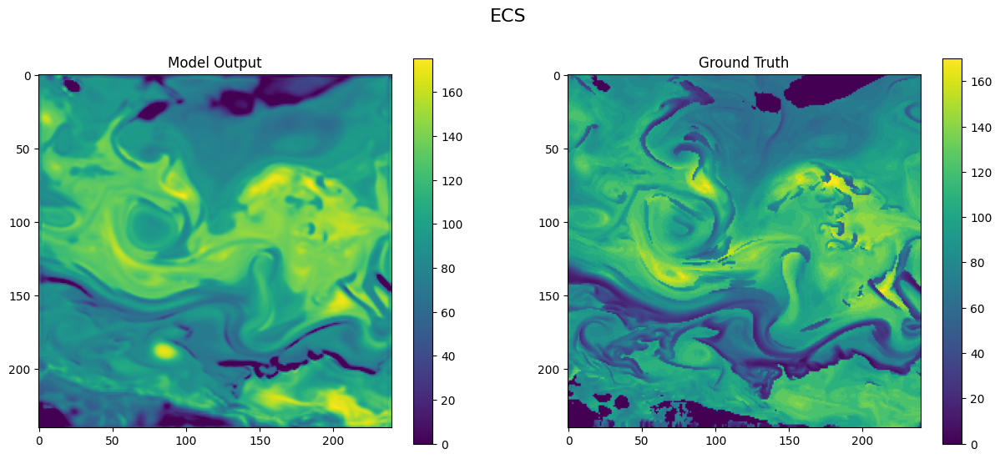

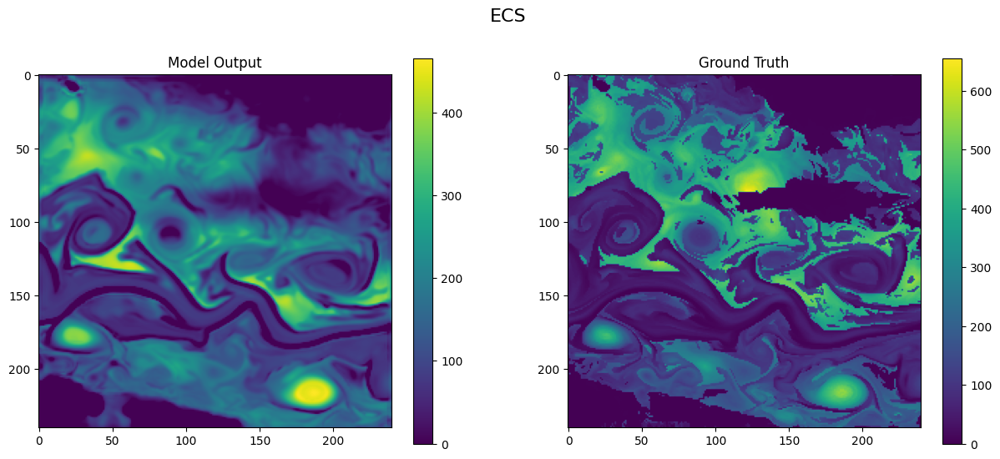

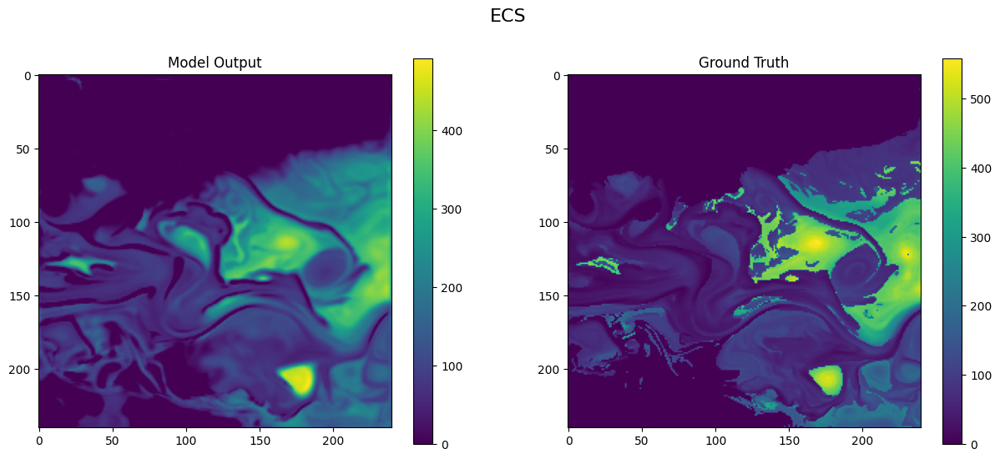

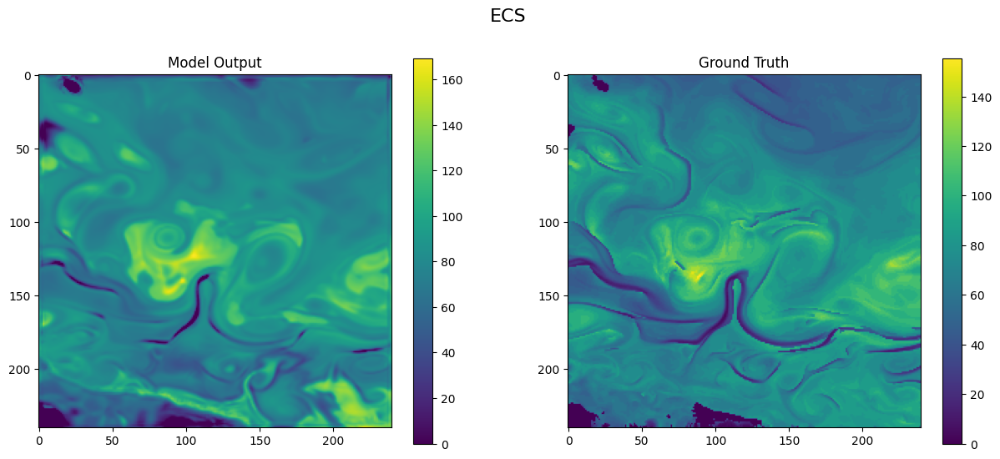

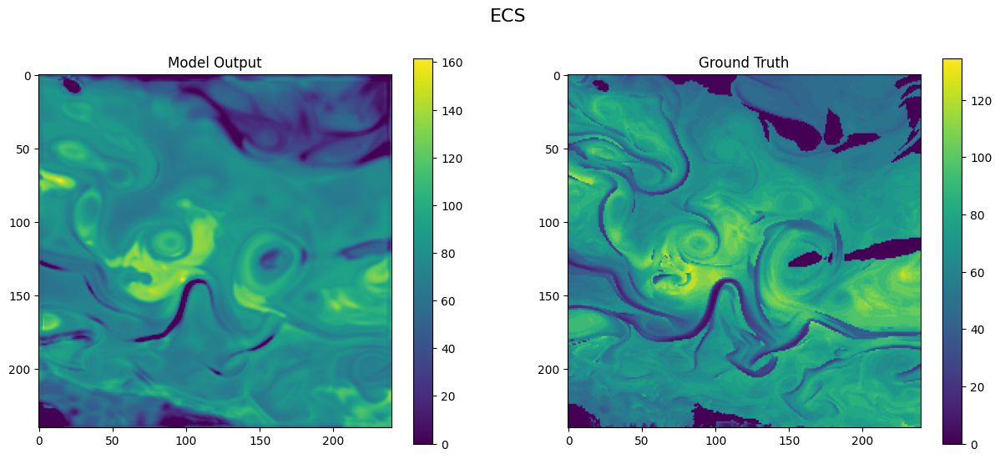

...

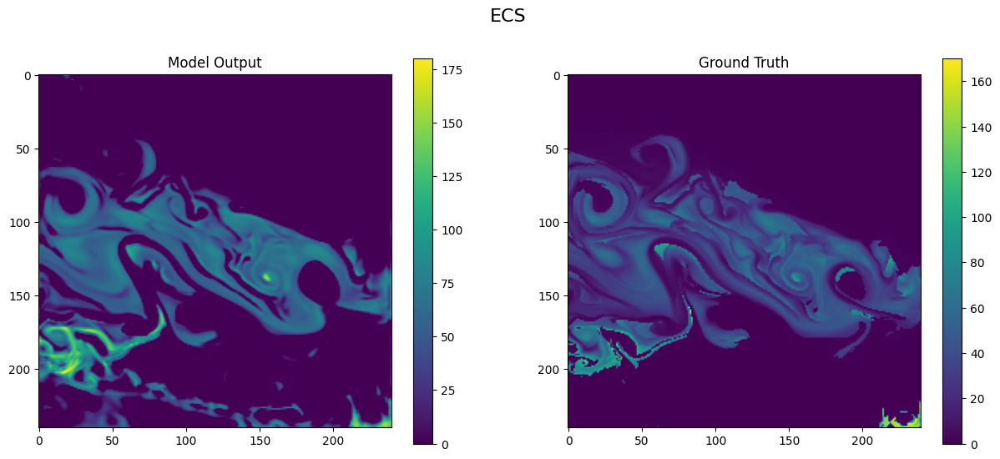

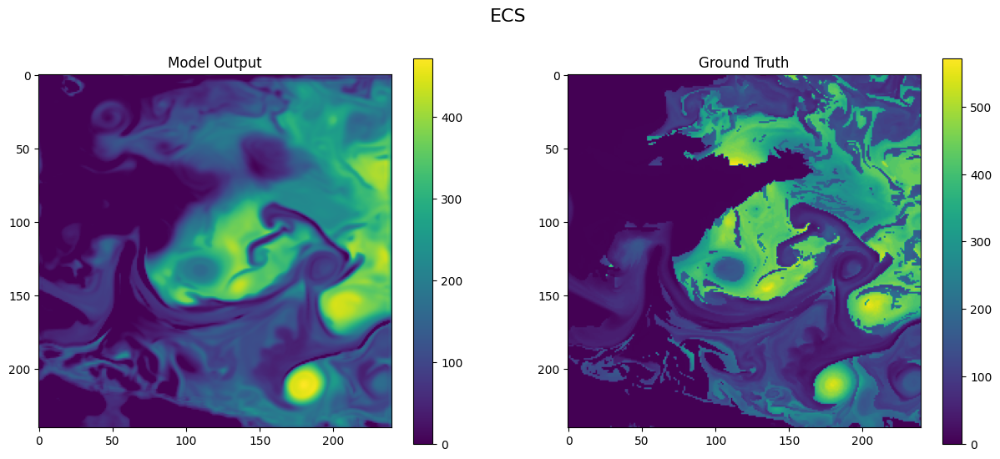

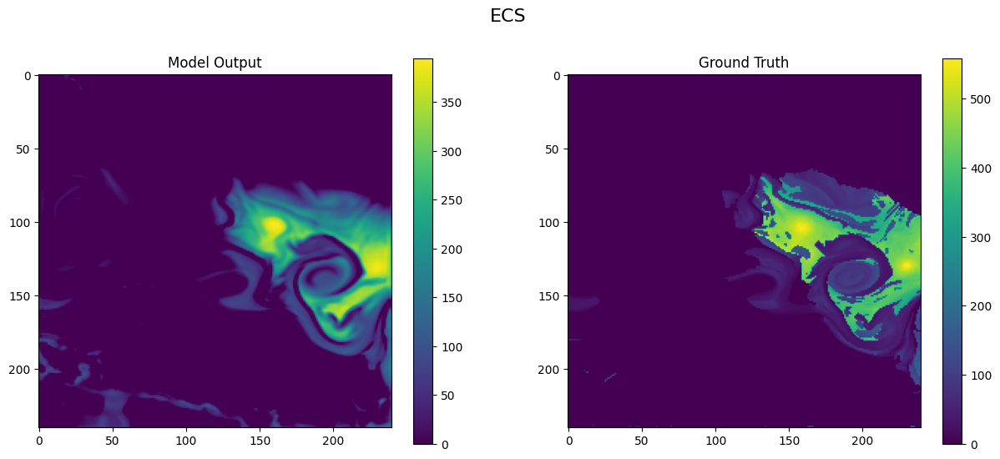

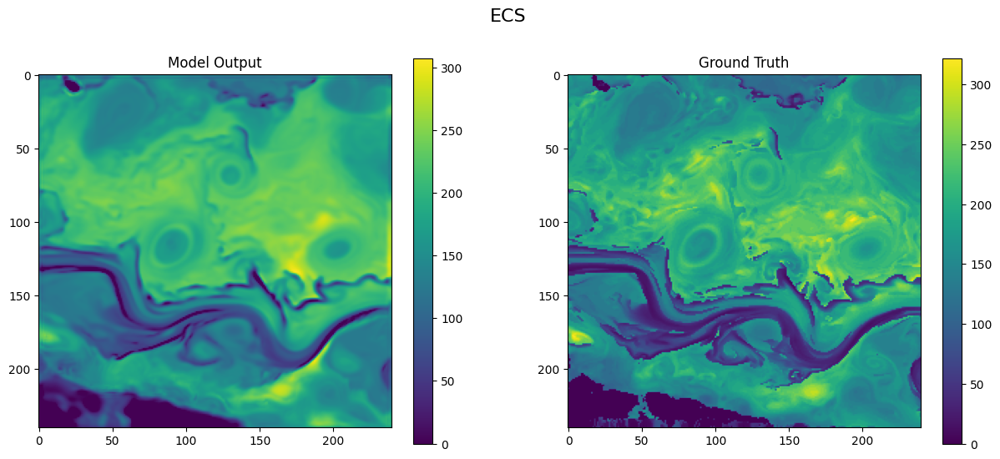

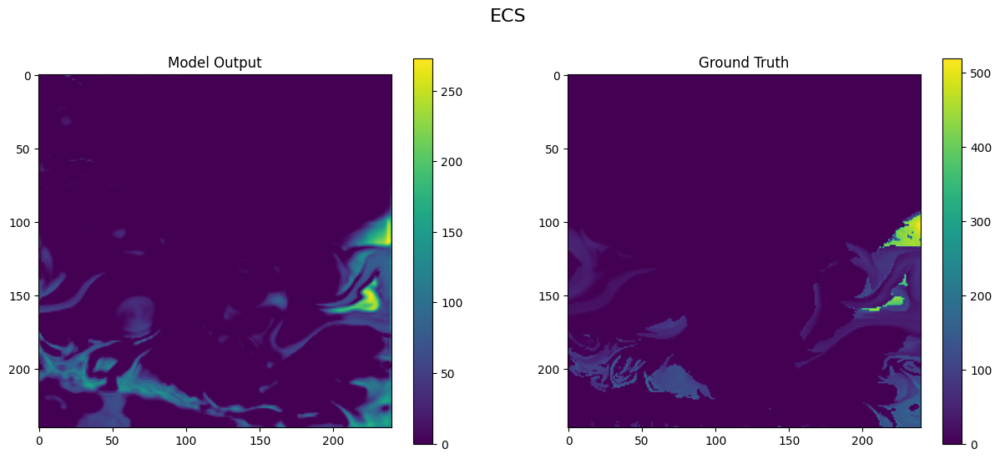

In [ ]:
# plotting model vs ground truth ecs maps for the whole test dataset

for batch in dataloader:
    check_maps(model_ap, batch, 1, "ECS")

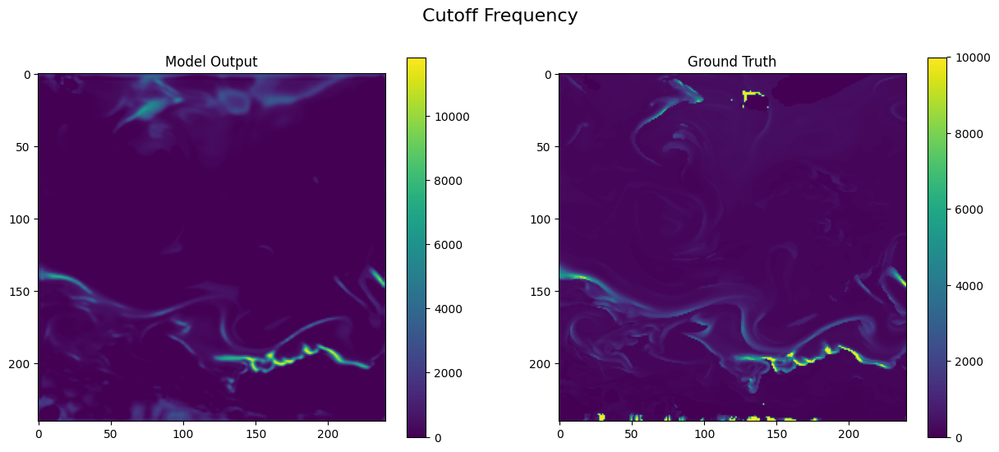

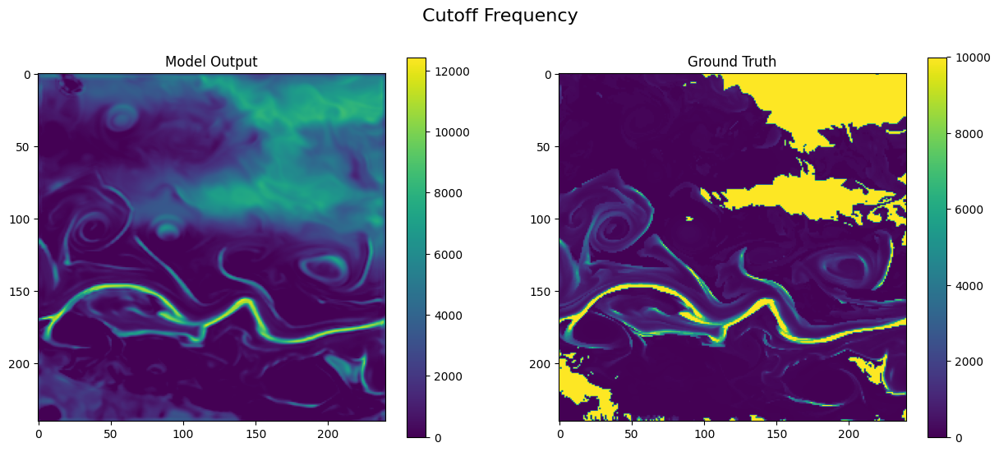

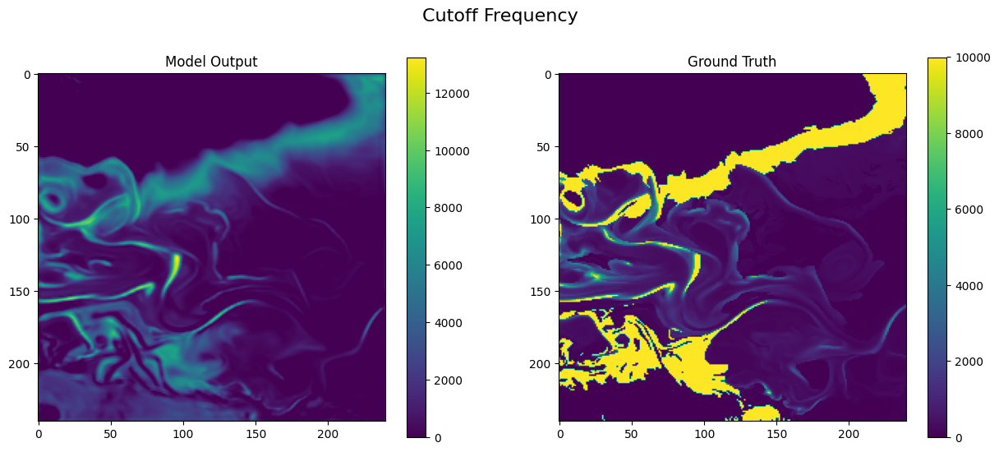

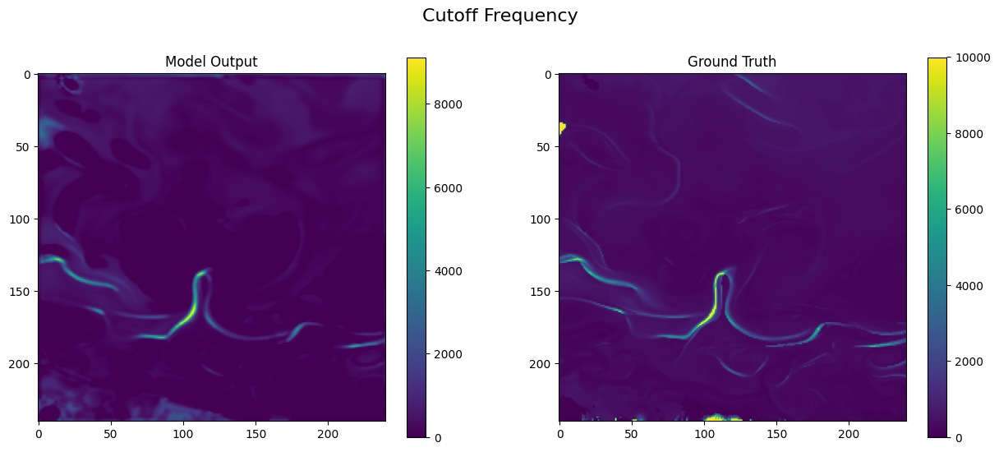

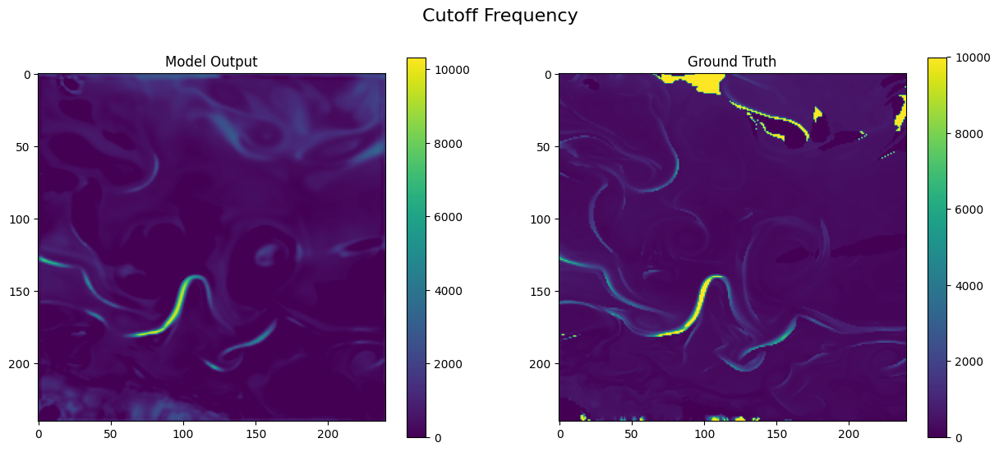

...

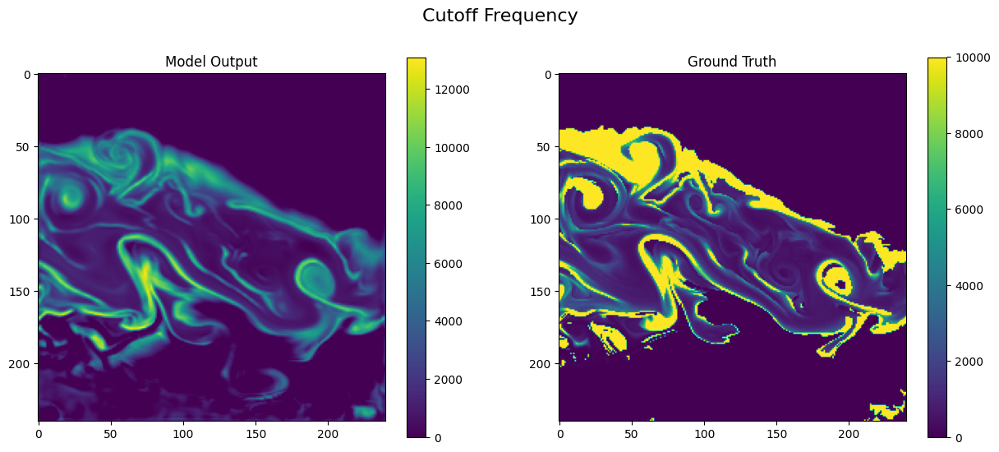

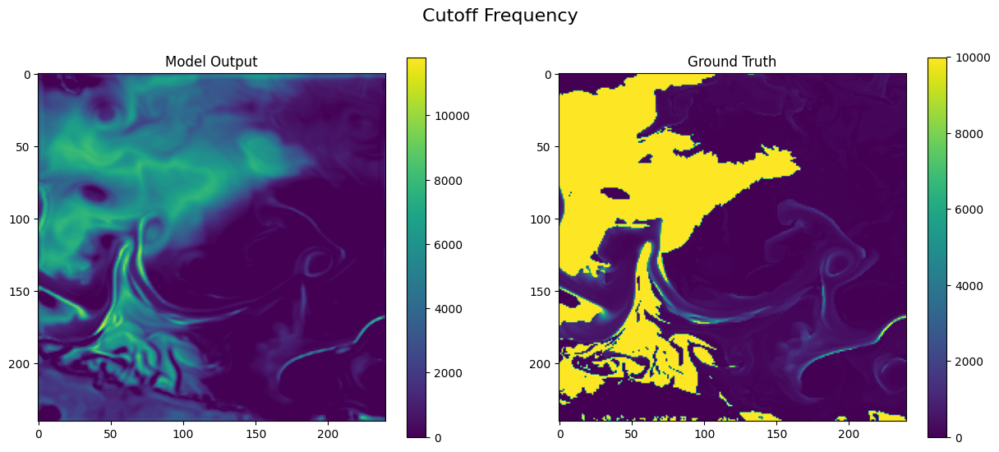

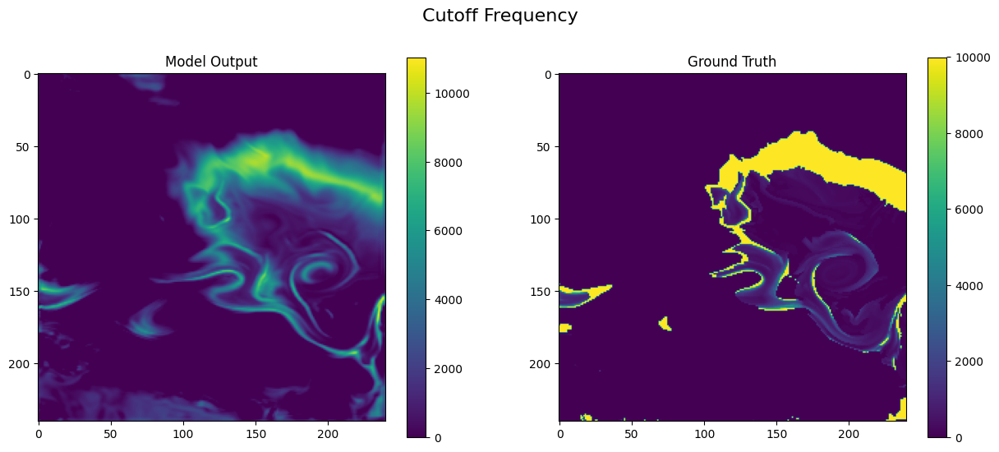

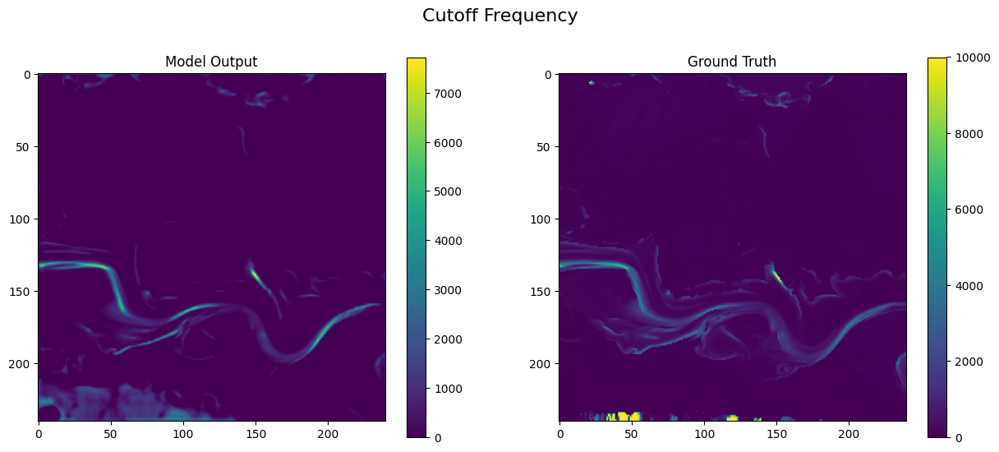

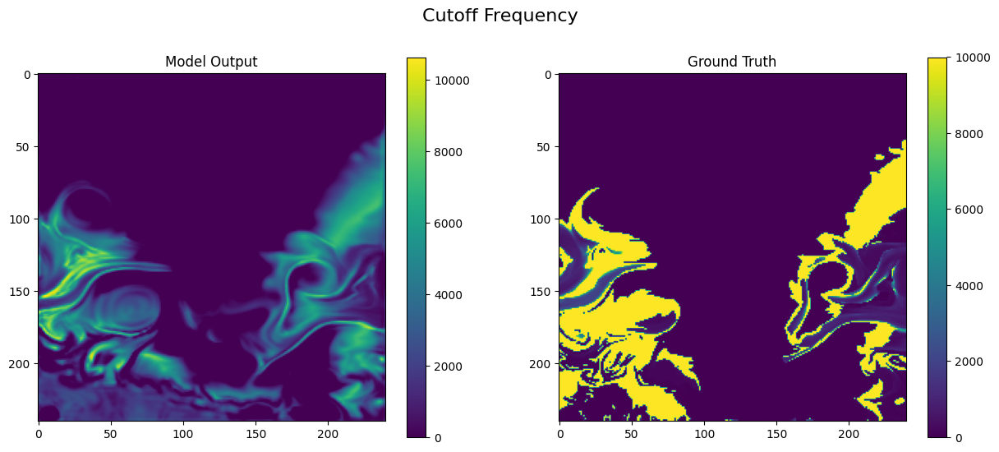

In [ ]:
# same with the cutoff frequency

for batch in dataloader:
    check_maps(model_ap, batch, 0, "Cutoff Frequency")

## AutoEncoder

In [ ]:
from src.autoencoder import AutoEncoder

In [ ]:
# path to the trained autoencoder weights, here trained without the additional acoustic predictor for the loss

model_path_ae = "outputs/AE_without_AP_baseline_unclean_data/16-45-39/AE_with_AP_training/checkpoints/val_loss=0.18-epoch=999.ckpt" #"outputs/2024-01-18/16-58-45/AE_with_AP_training/checkpoints/val_loss=0.01-epoch=998.ckpt"

In [ ]:
# loading model
# not putting it in eval mode here (do not think it is needed considering the model's architecture), but probably should out of safety

model_ae = AutoEncoder.load_from_checkpoint(model_path_ae, acoustic_predictor=model_ap)

In [ ]:
# accumulating errors over the test dataset

test_loss_list = []
idx = 0
for batch in dataloader:
    test_loss_list.append(model_ae.test_step(batch, idx))
    idx+=1

/homes/l19yakho/anaconda3/envs/fascination/lib/python3.11/site-packages/pytorch_lightning/core/module.py:377: UserWarning: You are trying to `self.log()` but the `self.trainer` reference is not registered on the model yet. This is most likely because the model hasn't been passed to the `Trainer`
  rank_zero_warn(


In [ ]:
# recalculating rmse by hand

ssf_rmse = 0
for el in test_loss_list:
    ssf_rmse += el.item()
ssf_rmse /= len(test_loss_list)
print(ssf_rmse)

2.3872187203831143


In [ ]:
# reconstructing output and ground truth data arrays for the calculation of spectral metrics

time, z, lat, lon = dm.test_time, dm.test_z, dm.test_lat, dm.test_lon
result_tensor = torch.cat([tensor for tensor in model_ae.test_data], dim=0)
outputs_array = xr.DataArray(result_tensor[:, 1, :, :, :].detach().cpu().numpy(), coords=[time, z, lat, lon], dims=["time", "z", "lat", "lon"])        
gt_array = xr.DataArray(result_tensor[:, 0, :, :, :].detach().cpu().numpy(), coords=[time, z, lat, lon], dims=["time", "z", "lat", "lon"])

In [ ]:
cs_ssf = []
for i in range (len(outputs_array.z)):
    cs_ssf.append(psd_based_scores(outputs_array.isel(z=i)*(1552.54994512 - 1438)+1438, gt_array.isel(z=i)*(1552.54994512 - 1438)+1438)[1])

In [ ]:
from statistics import mean

print(mean(cs_ssf))

0.488


In [ ]:
# function to plot slices of the ocean, here we set a value for the latitude and go over all the associated longitudes

def fixed_lat_plot(data1, data2, day=0, lat=0):
    implot1 = data1.sel(time=day)[:,lat,:]*(1552.54994512 - 1438)+1438
    implot2 = data2.sel(time=day)[:,lat,:]*(1552.54994512 - 1438)+1438
    fig, axes = plt.subplots(1, 2, figsize=(15, 6))
    cmap = plt.get_cmap('viridis')

    ax1 = axes[0]
    ax2 = axes[1]

    im1 = ax1.imshow(implot1, cmap=cmap)
    im2 = ax2.imshow(implot2, cmap=cmap)

    ax1.set_title("Model Output")
    ax2.set_title("Ground Truth")

    plt.suptitle("Sound Speed", fontsize=16)

    cbar1 = plt.colorbar(im1, ax=ax1)
    cbar2 = plt.colorbar(im2, ax=ax2)

    plt.show()

In [ ]:
# same as before except we fix the longitude instead

def fixed_lon_plot(data1, data2, day=0, lon=0):
    implot1 = data1.sel(time=day)[:,:,lon]*(1552.54994512 - 1438)+1438
    implot2 = data2.sel(time=day)[:,:,lon]*(1552.54994512 - 1438)+1438
    fig, axes = plt.subplots(1, 2, figsize=(15, 6))
    cmap = plt.get_cmap('viridis')

    ax1 = axes[0]
    ax2 = axes[1]

    im1 = ax1.imshow(implot1, cmap=cmap)
    im2 = ax2.imshow(implot2, cmap=cmap)

    ax1.set_title("Model Output")
    ax2.set_title("Ground Truth")

    plt.suptitle("Sound Speed", fontsize=16)

    cbar1 = plt.colorbar(im1, ax=ax1)
    cbar2 = plt.colorbar(im2, ax=ax2)

    plt.show()

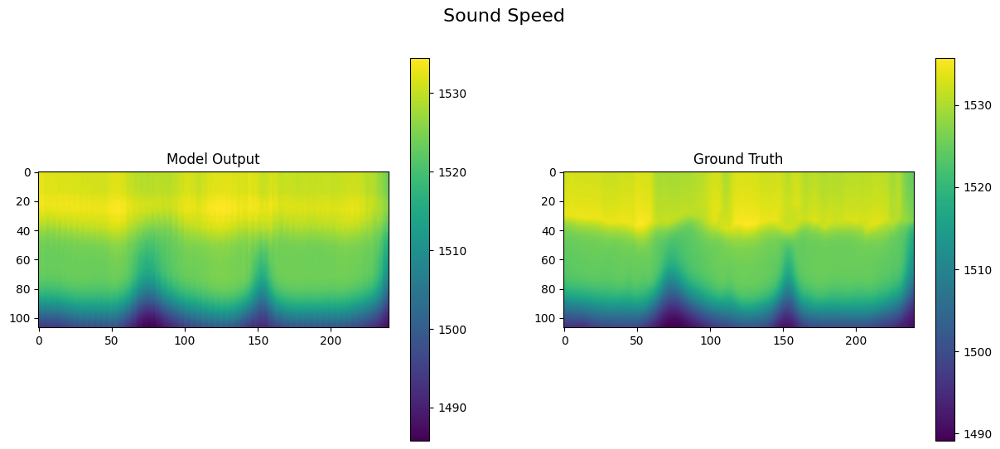

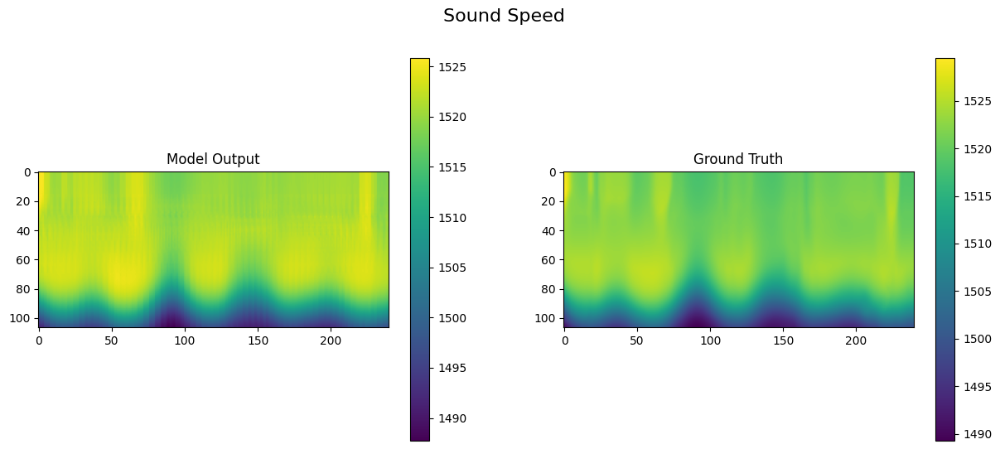

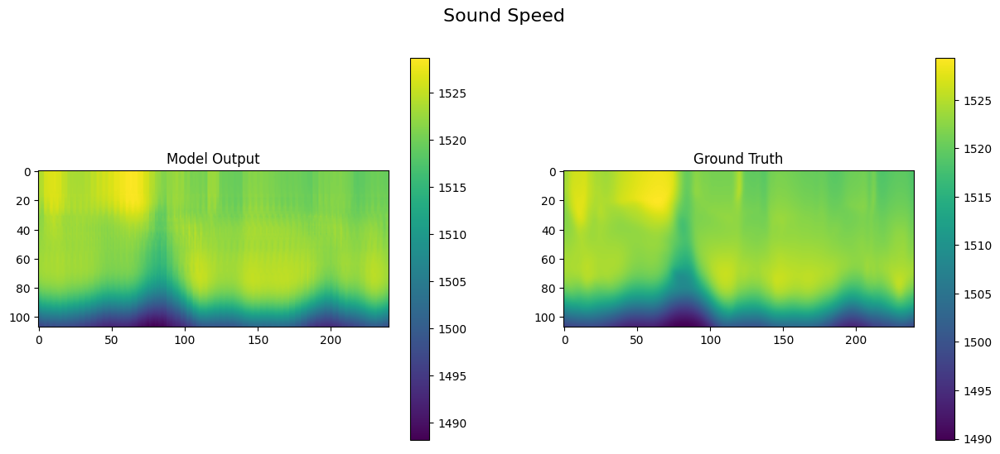

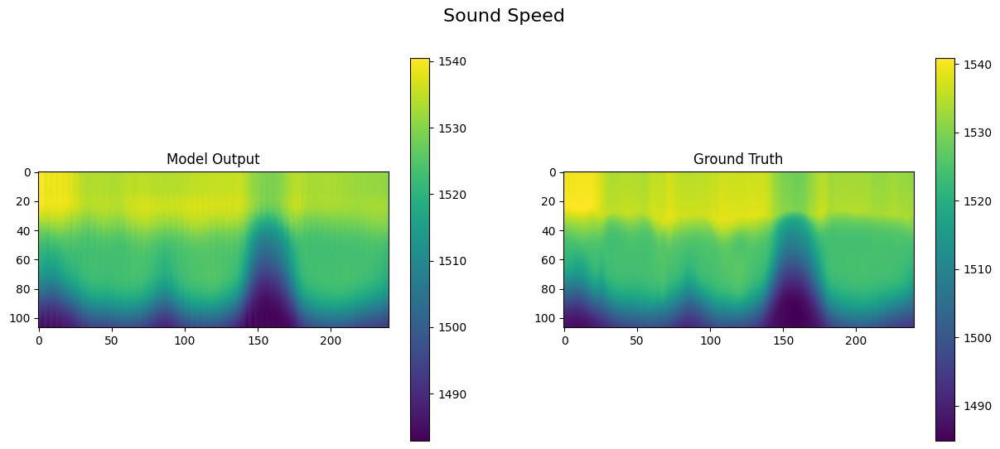

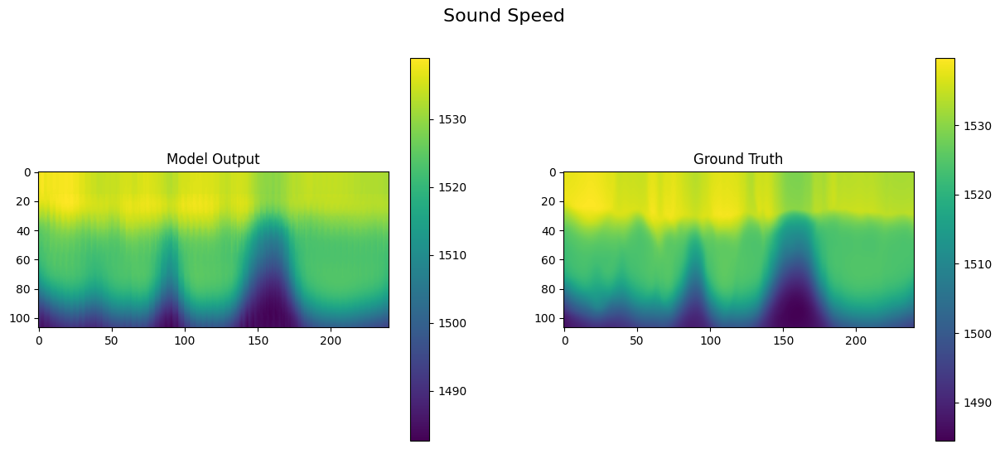

...

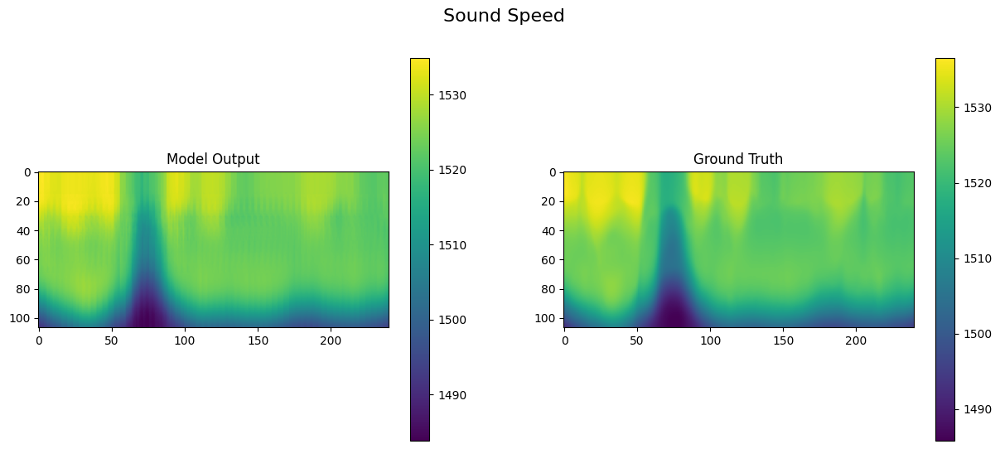

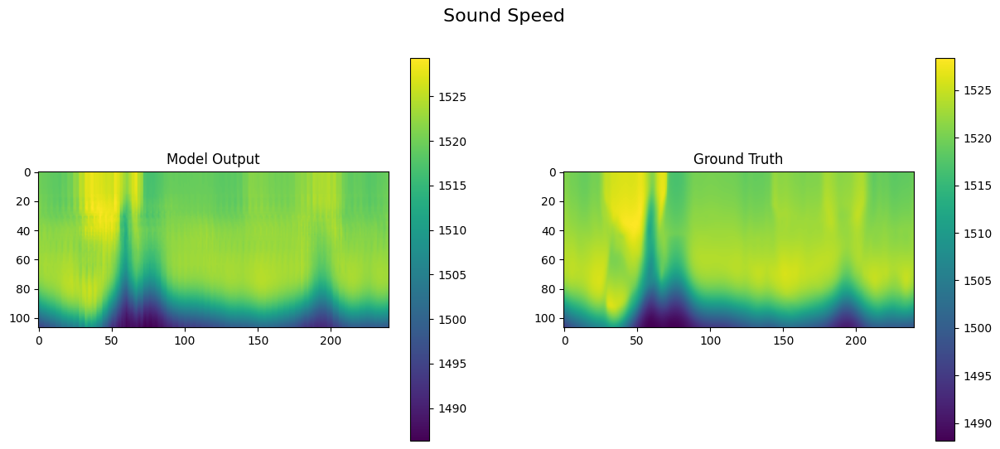

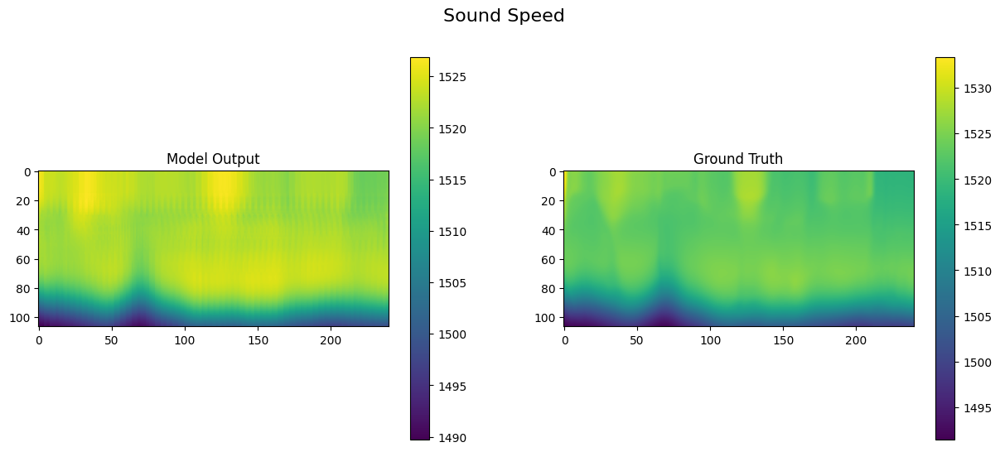

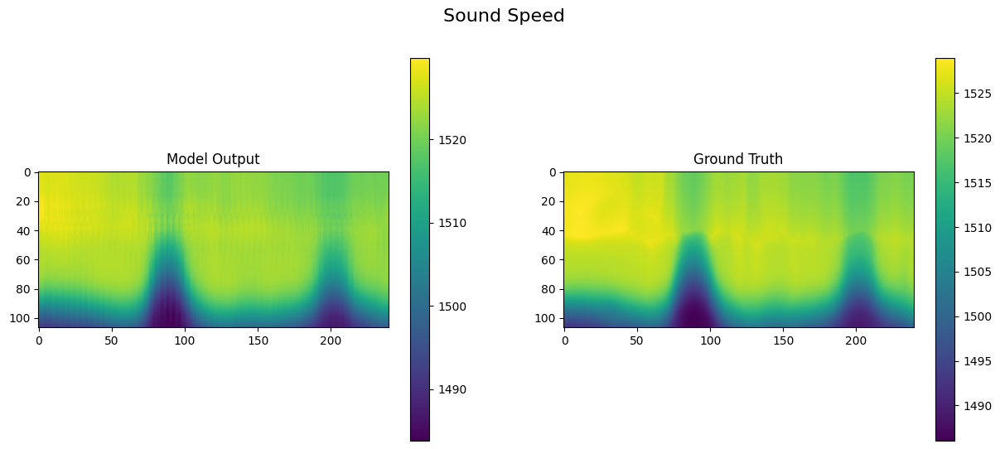

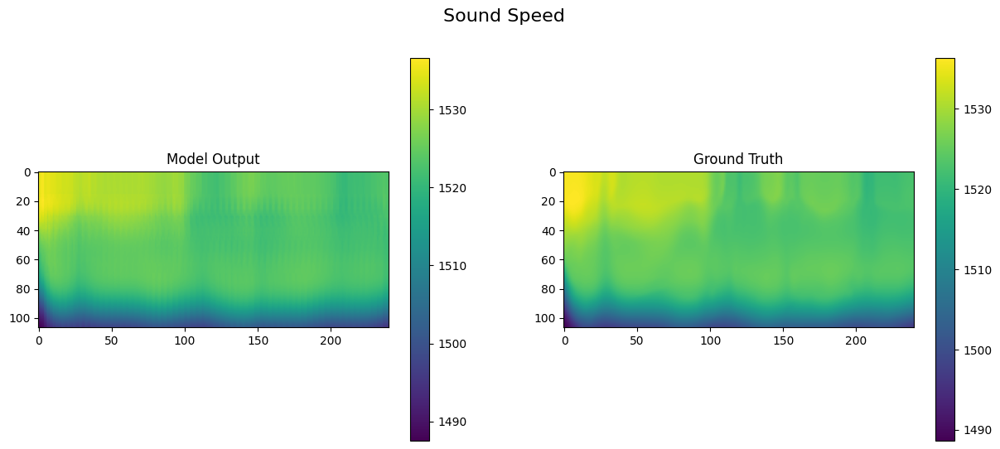

In [ ]:
for time in outputs_array.time:
    fixed_lat_plot(outputs_array, gt_array, time, lat=120)

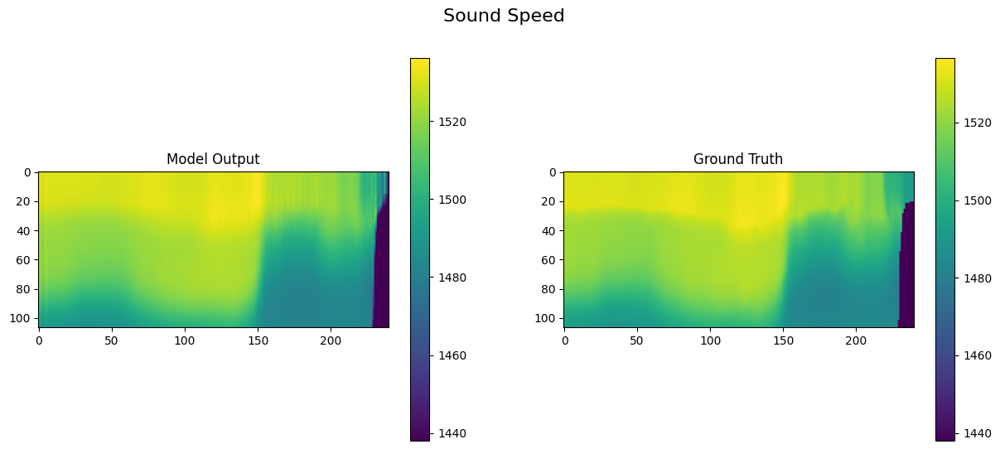

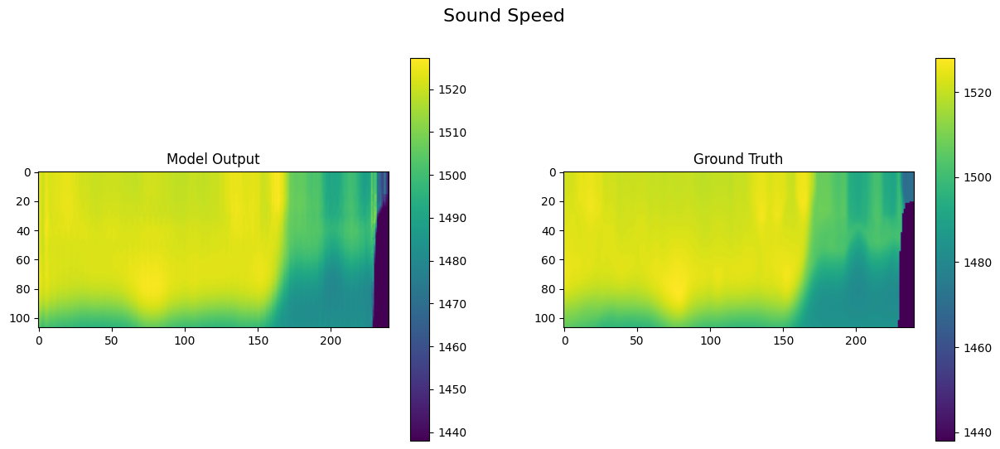

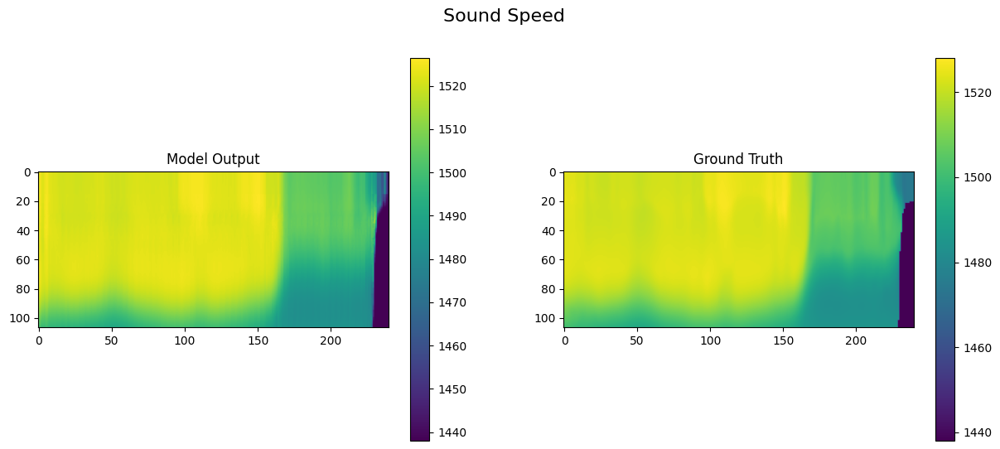

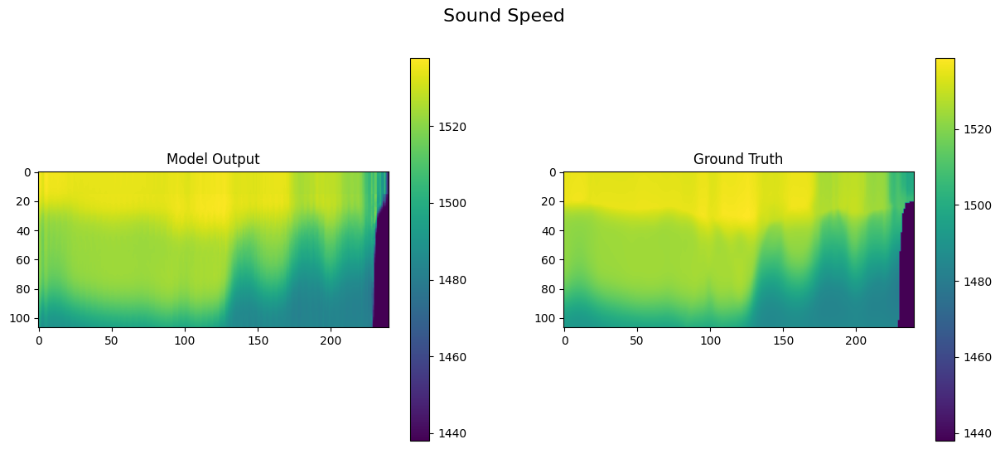

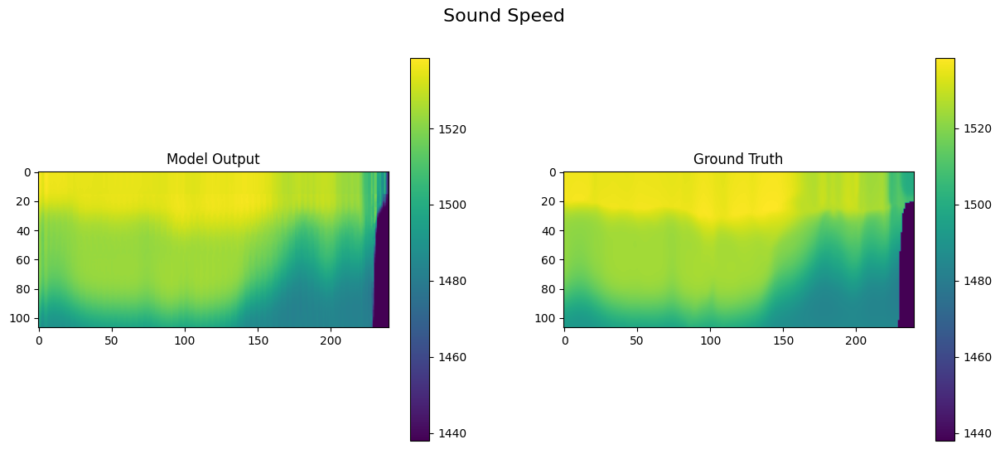

...

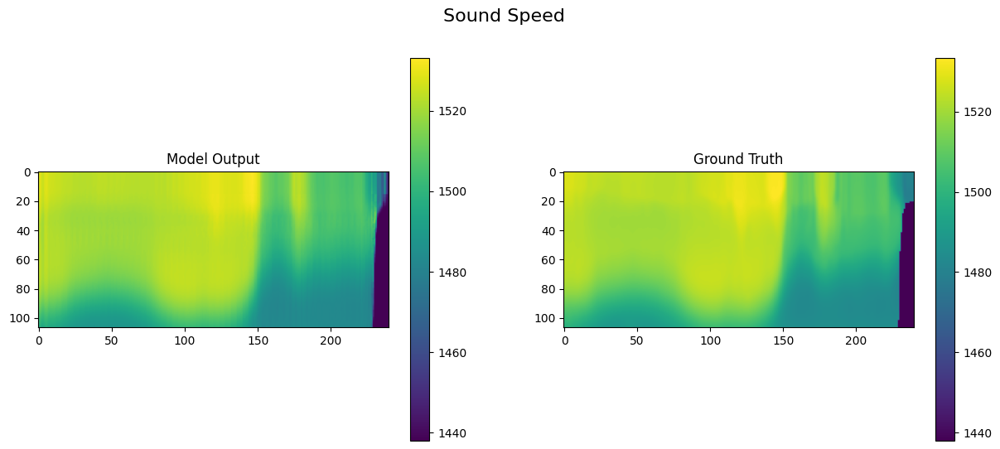

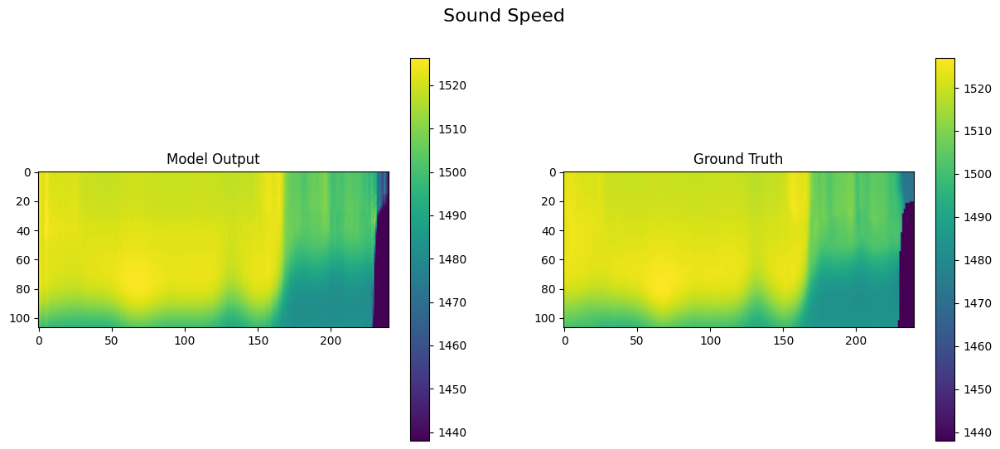

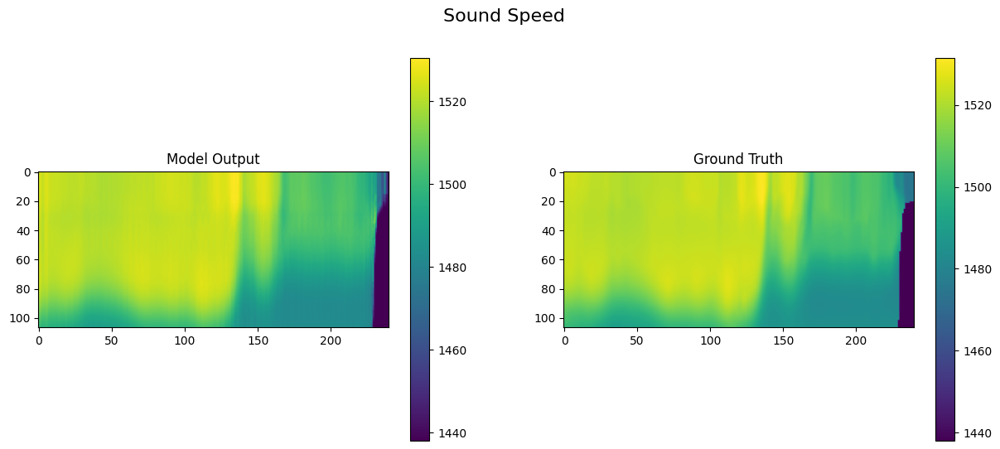

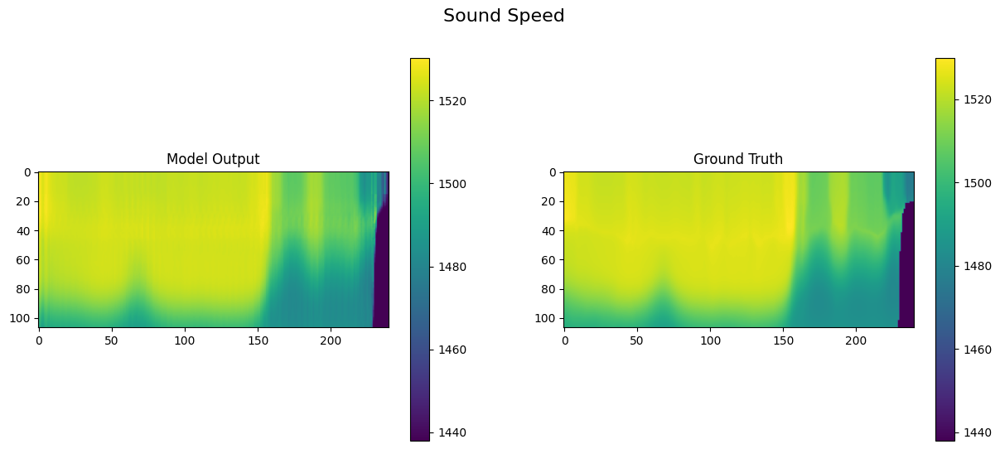

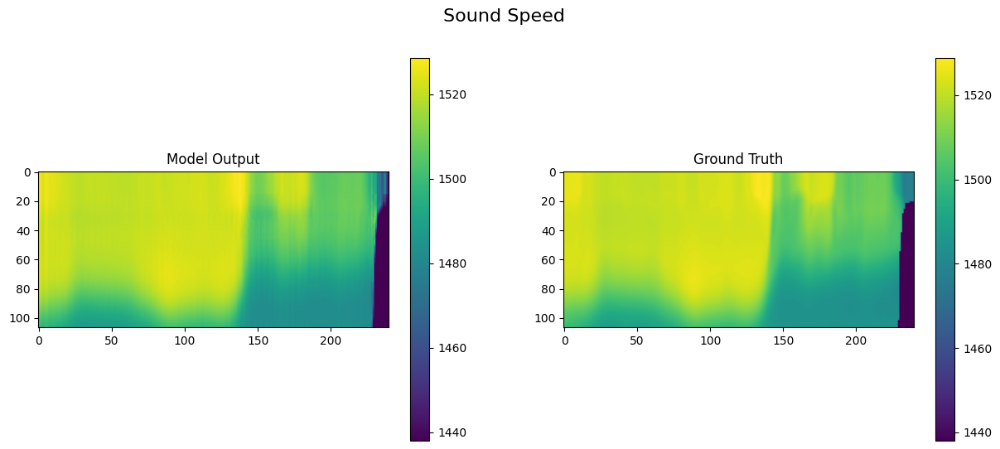

In [ ]:
for time in outputs_array.time:
    fixed_lon_plot(outputs_array, gt_array, time, lon=120)

# Loss curve analysis

In [ ]:
# loading autoencoder metrics

dataframe_ae = pd.read_csv("outputs/AE_without_AP_baseline_unclean_data/16-45-39/AE_with_AP_training/metrics.csv")
train_loss_ae = dataframe_ae.dropna(subset=['train_loss_epoch']) # dropping nan values out of the columns that interest us
val_loss_ae = dataframe_ae.dropna(subset=['val_loss']) # dropping nan values out of the columns that interest us

In [ ]:
# loading acoustic predictor metrics

dataframe_ap = pd.read_csv("outputs/AP_baseline_unclean_data/13-17-02/acoustic_pred_training/metrics.csv")
train_loss_ap = dataframe_ap.dropna(subset=['train_loss']) # dropping nan values out of the columns that interest us
val_loss_ap = dataframe_ap.dropna(subset=['val_loss']) # dropping nan values out of the columns that interest us

In [ ]:
dataframe_ae

,lr-Adam,step,train_loss_step,epoch,val_loss,train_loss_epoch,test_loss
0,0.001,0,NaN,NaN,NaN,NaN,NaN
1,0.001,49,NaN,NaN,NaN,NaN,NaN
2,NaN,49,0.209047,0.0,NaN,NaN,NaN
3,NaN,63,NaN,0.0,0.212890,NaN,NaN
4,NaN,63,NaN,0.0,NaN,0.241743,NaN
...,...,...,...,...,...,...,...
5556,0.001,63999,NaN,NaN,NaN,NaN,NaN
5557,NaN,63999,0.183549,999.0,NaN,NaN,NaN
5558,NaN,63999,NaN,999.0,0.183711,NaN,NaN
5559,NaN,63999,NaN,999.0,NaN,0.184292,NaN


In [ ]:
dataframe_ap

,lr-Adam,step,val_loss,epoch,train_loss
0,0.005000,0,NaN,NaN,NaN
1,NaN,63,0.050273,0.0,NaN
2,NaN,63,NaN,0.0,0.215179
3,0.004523,64,NaN,NaN,NaN
4,NaN,127,0.040901,1.0,NaN
...,...,...,...,...,...
5995,NaN,127935,0.056679,1998.0,NaN
5996,NaN,127935,NaN,1998.0,0.135289
5997,0.004523,127936,NaN,NaN,NaN
5998,NaN,127999,0.055202,1999.0,NaN


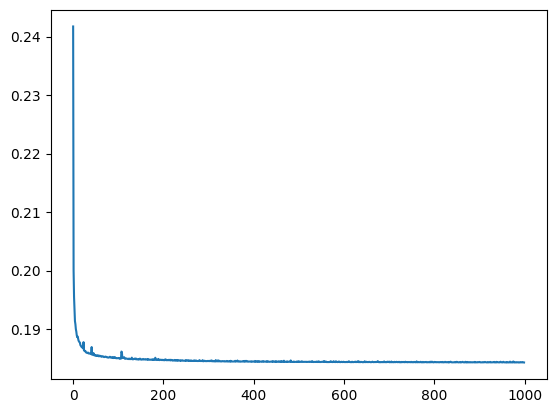

In [ ]:
# plotting training loss curve for the autoencoder

plt.plot(train_loss_ae['epoch'], train_loss_ae['train_loss_epoch'])

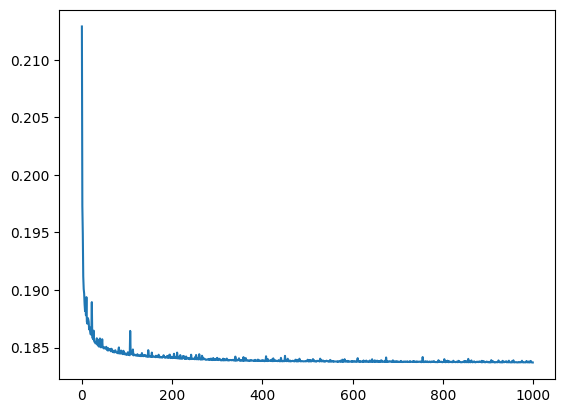

In [ ]:
# plotting validation loss curve for the autoencoder

plt.plot(val_loss_ae['epoch'], val_loss_ae['val_loss'])

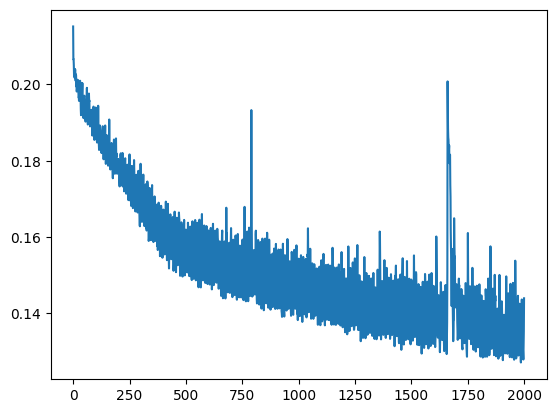

In [ ]:
# plotting training loss curve for the acoustic predictor

plt.plot(train_loss_ap['epoch'], train_loss_ap['train_loss'])

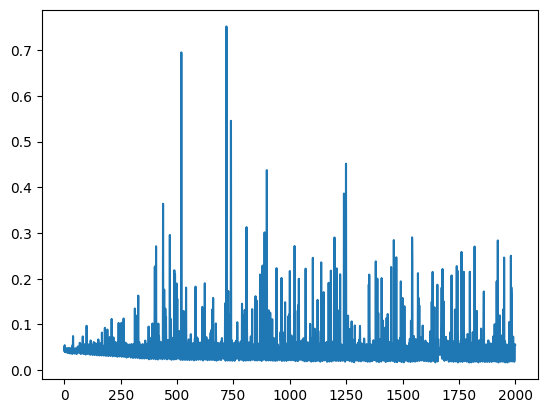

In [ ]:
# plotting validation loss curve for the acoustic predictor

plt.plot(val_loss_ap['epoch'], val_loss_ap['val_loss'])

# Saving File

In [6]:
arch_shape = "4_15"
ap_training = False
saving_path = "/DATASETS/envs/o23gauvr/"
phase = ["train", "val", "test"]
stage = dict(train = "fit",
             val = "fit",
             test = "test"
             )
input_da_path = "/DATASET/eNATL/eNATL60_BLB002_sound_speed_regrid_0_1000m.nc" 
model_path = "/homes/o23gauvr/Documents/thèse/code/FASCINATION/outputs/"

x_max = 1438
x_min = 1552.54994512



In [7]:
if ap_training : 
    ap_indicator = "AE_with_AP"
    model_ap_path = ""

else:
    ap_indicator = "AE_without_AP"
    model_ap_path = None
    
    
ap_indicator

'AE_without_AP'

In [8]:
model_ae_path = glob.glob(os.path.join(model_path,f"{ap_indicator}/{arch_shape}/**/*.ckpt"), recursive = True)[0]
model_ae_path

'/homes/o23gauvr/Documents/thèse/code/FASCINATION/outputs/AE_without_AP/4_15/AE_without_AP_training/4_15/checkpoints/val_loss=0.03-epoch=501.ckpt'

In [9]:
input_da = load_sound_speed_fields(input_da_path)

In [10]:
model_ae = AutoEncoder.load_from_checkpoint(model_ae_path,x_min = x_min, x_max = x_max, acoustic_predictor= model_ap_path, arch_shape = arch_shape).to(device)

In [12]:
model_ae.device

device(type='cuda', index=3)

In [13]:
phase = "train"

domains = dict(
    train = dict(time = slice(0, 254, None)),
    val = dict(time = slice(254, 331, None)),
    test = dict(time = slice(331, 365, None))
)


batch_size = dict(
    train=254,
    val=77,
    test=34
)


dl_kw = {
   'batch_size': batch_size[phase], 
    'num_workers': 1
}

coords = input_da.isel(domains[phase]).coords

In [14]:
dm = AutoEncoderDatamodule(input_da, domains, dl_kw, x_min=x_min, x_ma =x_max)
dm.setup(stage = stage[phase])

if phase == "train":
    dataloader = dm.train_dataloader()
    
elif phase == "val":
    dataloader = dm.val_dataloader()
    
elif phase == "test":
    dataloader = dm.test_dataloader()
    
    
if len(dataloader) != 1:
    raise ValueError("Dataloader should only contain 1 batch")



In [15]:
for batch in tqdm(dataloader):
    x, y = batch
    x,y = x.to(device),y.to(device)
    if not torch.equal(x,y):
        raise ValueError("x and y should be equal")

    if x.device != model_ae.device:
        raise ValueError(f"Dataloader and model should be on the same device. Dataloader is on {x.device}. Model is on {model_ae.device}")    

    output = model_ae(x)
    
    if not x.shape == output.shape:
        raise ValueError("Input and Output of the AutoEncoder should be of same shape")
    
    x,y,output = x*(x_max - x_min) + x_min, y*(x_max - x_min) + x_min, output*(x_max - x_min) + x_min

  0%|          | 0/1 [00:21<?, ?it/s]


TypeError: unsupported operand type(s) for -: 'NoneType' and 'NoneType'

In [ ]:
input_nc = xr.Dataarray(data = x.permute(2,3,1,0), coords = coords)